In [1]:
from py_tools import parse_dataset
from typing import List
import numpy as np

In [2]:
dataset = parse_dataset()

In [3]:
len(dataset.data)

40546

In [4]:
dataset.lasers[0].scan.shape[0]

180

In [5]:
a,b = dataset.lasers[0].XY
a.shape

(165,)

In [6]:
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import display, Math, Latex, Markdown, HTML

# Some Visualization

## Laser Scans alone 

To test if we parsed the dataset correctly

In [9]:
def animate_lidar(lidar_scans: List['np.array'], xlim, ylim, frames, fps = 30):
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_laser, y_laser = lidar_scans[0]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_laser, y_laser, 'o', color='orangered', markersize=3)

    def animate(i):
        start_frame = frames[1]
        skip_frames = frames[2]
        next_frame = start_frame + i*(skip_frames+1)
        laser = lidar_scans[next_frame]
        x_p, y_p = laser
        laser_line.set_data(x_p, y_p)
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [10]:
lidar_scans = [scan.XY for scan in dataset.lasers]

In [11]:
# xlim=(-20,20), ylim=(-1,25)
animate_lidar(lidar_scans, xlim=(-20,20), ylim=(-1,25), frames=(150, 200, 5))

In [12]:
# maximum value of laser range:
laser_max_val = max([max(laser.scan) for laser in dataset.lasers])
laser_max_val 
# Lets assume readings larger than 70 meters are not valid

81.83

## Using the odometery alone to draw trajectory

In [13]:
def animate_path(path: 'np.array', xlim, ylim, frames, fps = 30):
    start_frame = frames[0]
    skip_frames = frames[2]
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_p, y_p = [path[0,0]], [path[1,0]]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_p, y_p, '-', color='blue')
    
    def animate(i):
        end_frame = start_frame + i*(skip_frames+1)
        x_p, y_p = path[:, :end_frame]
        laser_line.set_data(x_p, y_p)
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [14]:
path = np.array([np.array([scan.x, scan.y]).reshape(2,1) for scan in dataset.lasers]).squeeze().T
path.shape

(2, 13631)

In [15]:
animate_path(path, xlim=(-60,25), ylim=(-40,25), frames=(150, 200+30, int((len(dataset.lasers) - 150)/200 ) ))

## Map with only Odometry data

In [16]:
print(min([scan.theta for scan in dataset.lasers]), max([scan.theta for scan in dataset.lasers]))

-3.136677 3.140363


In [17]:
from math import sin, cos
def xyt_2_transofmation(x,y,theta):
    rotation = np.array([[cos(theta), sin(theta)],[-sin(theta), cos(theta)]])
    translation = np.array([[x],[y]], dtype = np.float)
    transformation = np.identity(3, dtype=np.float)
    transformation[:2,:2] = rotation
    transformation[:2,[2]] = translation
    return transformation

In [18]:
def toHomogeneous(matrix):
    shape = matrix.shape
    res = np.ones((shape[0]+1 , shape[1]), dtype=np.float)
    res[:shape[0],:] = matrix
    return res

In [19]:
laser = dataset.lasers[0]
laser.XY.shape

(2, 165)

In [21]:
point_cloud = []
for laser in dataset.lasers:
    transformation = xyt_2_transofmation(laser.x, laser.y, laser.theta)
    h = toHomogeneous(laser.XY)
    point_cloud.append(np.matmul(transformation, h)[:2,:]) 

In [20]:
h = toHomogeneous(laser.XY)
h.shape

(3, 165)

In [33]:
def animate_map(map_data: List['np.array'], lengths, xlim, ylim, frames, fps = 30):
    start_frame = frames[0]
    skip_frames = frames[2]
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_p, y_p = map_data[0]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_p, y_p, '.', color='orangered', markersize=1)
    
    map_data = np.concatenate(map_data, axis = 1)

    def animate(i):
        end_frame = start_frame + i*(skip_frames+1)
        s = sum(lengths[:max(end_frame-int(skip_frames*fps*0.75), 0)])
        e = sum(lengths[:end_frame])  # end_frame*180
        x_p, y_p = map_data[:, s:e]
        laser_line.set_data(x_p, y_p)
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [40]:
skip = int((len(dataset.lasers) - 150)/200)
skip = 1
animate_map(point_cloud, 
            lengths=dataset.length_lasers , 
            xlim=(-60,25), ylim=(-40,25), 
            frames=(150, 1000,  skip), 
            fps = 30)

# Start the ICP

## Comparing only two scans

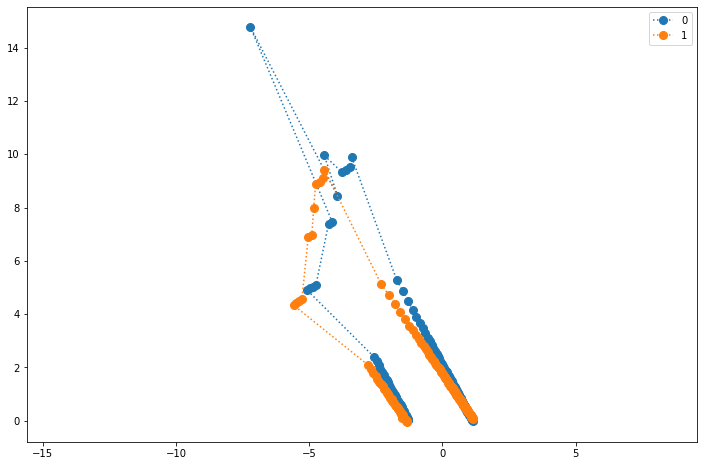

In [100]:
idx =  170
scans = [dataset.lasers[idx], dataset.lasers[idx + 1] ]

# Draw scans but in the first scan's frame after appplying the odom info to see the error of the odom alone
Ts = [xyt_2_transofmation(scan.x, scan.y, scan.theta) for scan in scans]

cloud = []
ref = Ts[0]
ref_inv = np.linalg.inv(ref)
for scan, t in zip(scans, Ts):
    transformed_points = (ref_inv @ t).dot(toHomogeneous(scan.XY))
    cloud.append(transformed_points[:2,:])

def plot_data(data):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111)
    ax.axis('equal')
    for idx, d in enumerate(data):
        x_p, y_p = d
        ax.plot(x_p, y_p, markersize=8, marker='o', linestyle=":", label="{}".format(idx))
    ax.legend()
    return ax

plot_data(cloud)